### 1.Importing and loading the data

In [3]:
import pandas as pd
import numpy as np
import plotly.express as px
import seaborn as sns

In [4]:
df = pd.read_csv("/kaggle/input/playground-series-s3e16/train.csv")
df

,id,Sex,Length,Diameter,Height,Weight,Shucked Weight,Viscera Weight,Shell Weight,Age
0,0,I,1.5250,1.1750,0.3750,28.973189,12.728926,6.647958,8.348928,9
1,1,I,1.1000,0.8250,0.2750,10.418441,4.521745,2.324659,3.401940,8
2,2,M,1.3875,1.1125,0.3750,24.777463,11.339800,5.556502,6.662133,9
3,3,F,1.7000,1.4125,0.5000,50.660556,20.354941,10.991839,14.996885,11
4,4,I,1.2500,1.0125,0.3375,23.289114,11.977664,4.507570,5.953395,8
...,...,...,...,...,...,...,...,...,...,...
74046,74046,F,1.6625,1.2625,0.4375,50.660556,20.680960,10.361742,12.332033,10
74047,74047,I,1.0750,0.8625,0.2750,10.446791,4.323299,2.296310,3.543687,6
74048,74048,F,1.4875,1.2000,0.4125,29.483480,12.303683,7.540967,8.079607,10
74049,74049,I,1.2125,0.9625,0.3125,16.768729,8.972617,2.919999,4.280774,8


### 2.Data preprocessing

In [5]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 74051 entries, 0 to 74050
Data columns (total 10 columns):
 #   Column          Non-Null Count  Dtype  
---  ------          --------------  -----  
 0   id              74051 non-null  int64  
 1   Sex             74051 non-null  object 
 2   Length          74051 non-null  float64
 3   Diameter        74051 non-null  float64
 4   Height          74051 non-null  float64
 5   Weight          74051 non-null  float64
 6   Shucked Weight  74051 non-null  float64
 7   Viscera Weight  74051 non-null  float64
 8   Shell Weight    74051 non-null  float64
 9   Age             74051 non-null  int64  
dtypes: float64(7), int64(2), object(1)
memory usage: 5.6+ MB


<b>All columns are of appropriate data type</b>

In [6]:
df.isna().sum()

id                0
Sex               0
Length            0
Diameter          0
Height            0
Weight            0
Shucked Weight    0
Viscera Weight    0
Shell Weight      0
Age               0
dtype: int64

**There are no empty values**

In [7]:
df = df.set_index("id")
df = pd.get_dummies(df,"Sex") #Encoding the categorical columns

In [8]:
df.var()

Length              0.082804
Diameter            0.056357
Height              0.008470
Weight            159.975774
Shucked Weight     31.562209
Viscera Weight      7.799334
Shell Weight       12.847723
Age                10.081826
Sex_F               0.214180
Sex_I               0.218858
Sex_M               0.231980
dtype: float64

#### Relationship with the target variable

CPU times: user 17.2 s, sys: 515 ms, total: 17.7 s
Wall time: 17.2 s


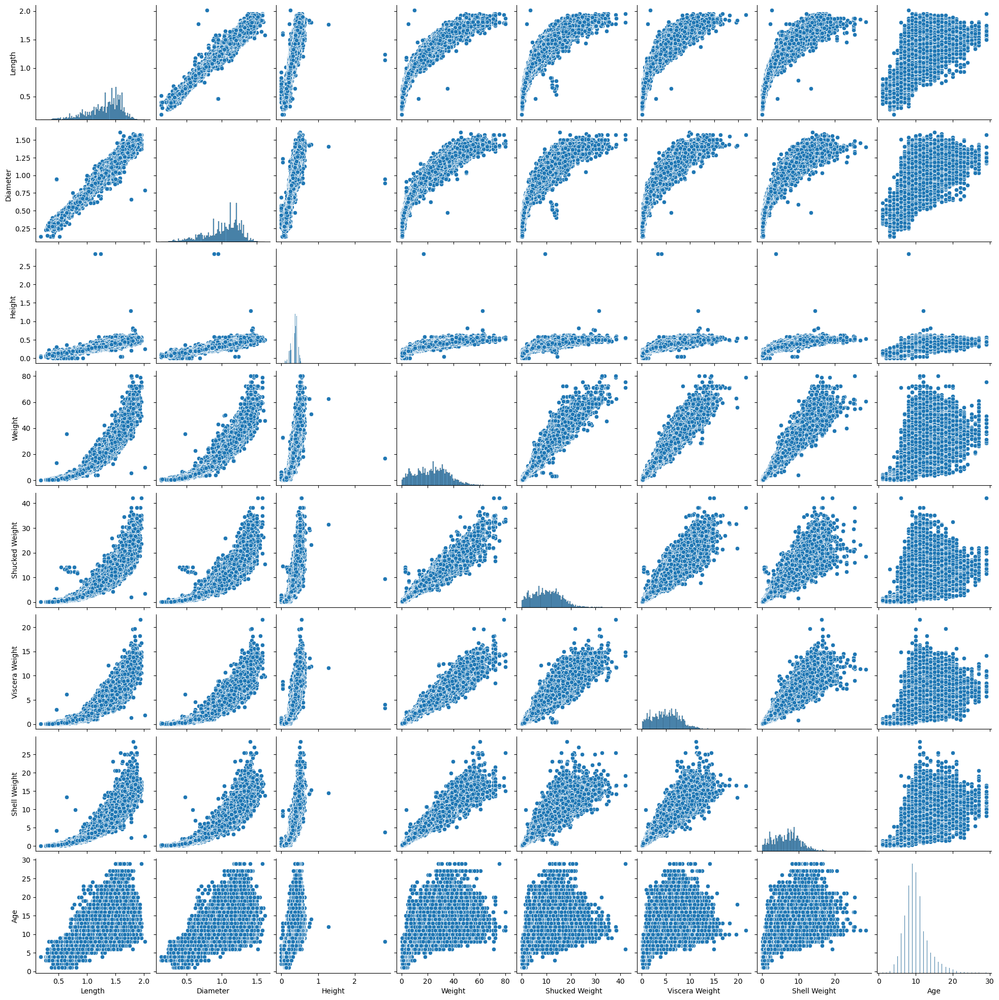

In [9]:
%%time
sns.pairplot(df.iloc[:,:-3])

**The independent variables do not have a strict linear relationship with the Age column. So a plain linear model may not be a good predictor**

#### Distribution of data

array([[<Axes: title={'center': 'Length'}>,
        <Axes: title={'center': 'Diameter'}>,
        <Axes: title={'center': 'Height'}>],
       [<Axes: title={'center': 'Weight'}>,
        <Axes: title={'center': 'Shucked Weight'}>,
        <Axes: title={'center': 'Viscera Weight'}>],
       [<Axes: title={'center': 'Shell Weight'}>,
        <Axes: title={'center': 'Age'}>,
        <Axes: title={'center': 'Sex_F'}>],
       [<Axes: title={'center': 'Sex_I'}>,
        <Axes: title={'center': 'Sex_M'}>, <Axes: >]], dtype=object)

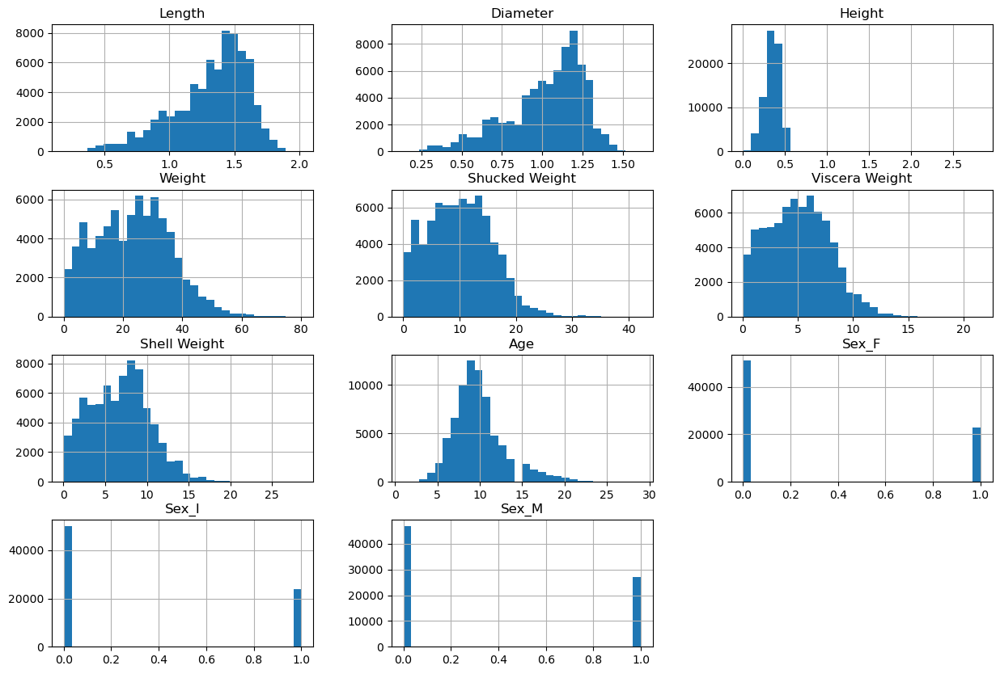

In [10]:
df.hist(bins=30, figsize=(15, 10))

#### Removing outliers

In [11]:
#Let us have a look at the outliers in the data
px.box(df.iloc[:,:-4], height=500)

None of the columns have a normal distribution of data

In [12]:
def remove_outlier_for_cols(df:pd.DataFrame, iqr_multiplier:float, cols:list)->pd.DataFrame:
    """
    Removes outliers for the given set of quantile

    Parameters:
        df: The dataframe whose outliers have to be removed
        iqr_range: The lower and upper limits of data that needs to be retained eg. [0.3, 0.7]
        cols: The columns for which you want to remove the outliers    
    """
    for col in cols:
        q_low, q_high = np.percentile(df[col], [25, 75])
        approved_range = (q_high - q_low)*iqr_multiplier
        lower_lt = q_low - approved_range
        upper_lt = q_high + approved_range
        
        df = df.loc[(df[col]>lower_lt) & (df[col]<upper_lt)]
        
    return df

In [13]:
df_out_rmvd = remove_outlier_for_cols(df, 1.5, ['Length', 'Diameter', 'Height', 'Weight', 'Shucked Weight', 'Viscera Weight', 'Shell Weight'])
print(df_out_rmvd.shape, df.shape)

(71313, 11) (74051, 11)


About 2% of datapoints have been determined as outliers and removed from the dataset.

In [14]:
df = df_out_rmvd
px.box(df.iloc[:,:-4], height=500)

#### Splitting the and dependent and independent variables

In [15]:
y = df.loc[:,["Age"]]
X = df.drop(columns="Age")

In [16]:
from sklearn.model_selection import train_test_split

In [17]:
X_train, X_test, y_train, y_test = train_test_split(X, y, random_state=200, test_size=0.2, shuffle=True)

#### Scaling

In [18]:
from sklearn.preprocessing import StandardScaler
scaler = StandardScaler()

# Standardizing the independent features
def df_scaler(df, scaler_object, trans_type):
    """
    Returns the scaled dataframe and the scaler object for the transform or fit_transform
    
    """
    df_cols = list(df.columns)
    if trans_type == "fit":
        scaler_object.fit(df)
    elif trans_type == "transform":
        df = scaler_object.transform(df)
    else:
        df = scaler_object.fit_transform(df)
    df = pd.DataFrame(data=df, columns=df_cols)
    return df, scaler_object

In [19]:
X_train_std, scaler = df_scaler(X_train, scaler, "fit_transform")

### 3. Feature Selection and Extraction

<Axes: >

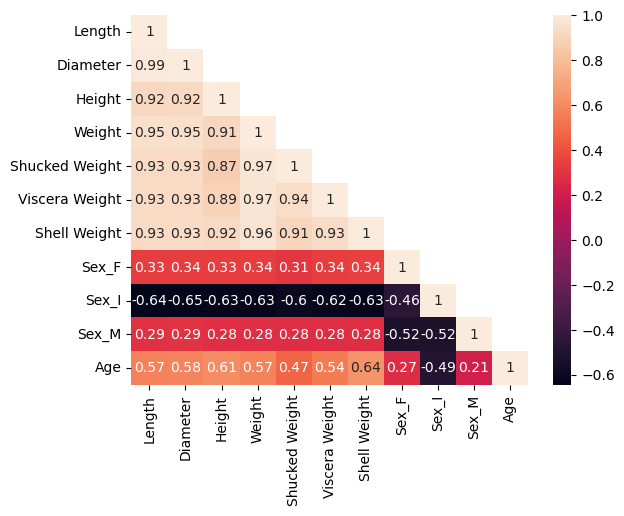

In [20]:
df_merge = pd.concat([X_train, y_train], axis=1)
corr_matrix = df_merge.corr(numeric_only=True)#.sort_values(by='Age', ascending=False)
# sns.heatmap(df_merge.corr().sort_values(by='Age', ascending=False).loc[:,["Age"]], annot=True)
mask = np.triu(corr_matrix, np.ones_like(corr_matrix, dtype=bool).any())
sns.heatmap(data=corr_matrix, mask=mask, annot=True)

<b>As we are aimed at prediting the crab age the strong multicollinearity will not affect our results.<br>Nevertheless, let us go ahead and try to tackle multicollinearity by using<br>1.PCA<br>2.Ridge regression</b>

In [21]:
from sklearn.decomposition import PCA
pca=PCA()
X_train_pca = pca.fit_transform(X_train_std)[:,0:4]
np.cumsum(np.round(pca.explained_variance_ratio_, decimals = 4)*100)[0:4]

array([72.95, 88.23, 95.94, 97.44])

In [22]:
X_train_pca.shape

(57050, 4)

### 3.Model training

#### Ridge regression

In [23]:
from sklearn.model_selection import GridSearchCV
from sklearn.model_selection import RepeatedKFold
from sklearn.linear_model import Ridge

# define model
ridge_model = Ridge()

# Model evaluation method
cv = RepeatedKFold(n_splits=10, n_repeats=3, random_state=1)
# Grid
grid = dict()
grid['alpha'] = np.arange(0, 1, 0.01)
# Search
search = GridSearchCV(
    estimator=ridge_model, 
    param_grid=grid, 
    scoring='neg_mean_squared_error', 
    cv=cv, 
    n_jobs=-1
)

In [24]:
X_grid_std, y_grid_std = X_train_std.copy(), np.ravel(y_train).copy()

# perform the search
results = search.fit(X_grid_std, y_grid_std)
# summarize
print(f'MAE: {results.best_score_}')
print(f'Config: {results.best_params_}')

/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_ridge.py:216: LinAlgWarning: Ill-conditioned matrix (rcond=6.09528e-18): result may not be accurate.
  return linalg.solve(A, Xy, assume_a="pos", overwrite_a=True).T
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_ridge.py:216: LinAlgWarning: Ill-conditioned matrix (rcond=8.52895e-17): result may not be accurate.
  return linalg.solve(A, Xy, assume_a="pos", overwrite_a=True).T
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_ridge.py:216: LinAlgWarning: Ill-conditioned matrix (rcond=4.26334e-17): result may not be accurate.
  return linalg.solve(A, Xy, assume_a="pos", overwrite_a=True).T
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_ridge.py:216: LinAlgWarning: Ill-conditioned matrix (rcond=7.31436e-17): result may not be accurate.
  return linalg.solve(A, Xy, assume_a="pos", overwrite_a=True).T
/opt/conda/lib/python3.10/site-packages/sklearn/linear_model/_ridge.py:216: LinAlgWarnin

MAE: -4.4838690825455085
Config: {'alpha': 0.99}


In [25]:
X_grid_pca, y_grid_pca = X_train_pca.copy(), np.ravel(y_train).copy()

# perform the search
results = search.fit(X_grid_pca, y_grid_pca)
# summarize
print('MAE: %.3f' % results.best_score_)
print('Config: %s' % results.best_params_)

MAE: -5.315
Config: {'alpha': 0.99}


**Interestingly we find that the best alpha for the ridge regression to be 0, implying that the the plain old regression is the best option. Also the model with PCA components has performed poorer than the original features.**

### 5.Predicting for the competition test values

In [26]:
from sklearn.linear_model import LinearRegression
lin_reg = LinearRegression()

In [27]:
lin_reg.fit(X_train_std, y_train)

LinearRegression()

In [28]:
test_df_comp = pd.read_csv("/kaggle/input/playground-series-s3e16/test.csv").set_index("id")
test_df_comp = pd.get_dummies(test_df_comp, columns=['Sex'])
X_test_std_comp, scaler = df_scaler(test_df_comp, scaler, "transform")
final_predicted_y = lin_reg.predict(X_test_std_comp)

In [29]:
predicted_dataframe = pd.DataFrame({
    "id": test_df_comp.index,
    "Age": final_predicted_y.flatten()
})

In [30]:
predicted_dataframe = predicted_dataframe.set_index("id")
predicted_dataframe.to_csv("Final_submission_BA.csv")